I started with a simple image recognition model to find Santa Claus pictures.  At first, the model relied mostly on the red color of Santa's suit.  Now, I'm making the model smarter!  I'm using a special technique to change the colors in Santa's pictures.  This will help the model learn to recognize Santa even when his suit isn't red.  By the end, I'll see if this trick helps the model find Santa more accurately.

# data preparing

In [1]:
import io
import os
import random
import zipfile
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, MaxPool2D
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator

2024-03-28 04:48:33.314291: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-03-28 04:48:33.314506: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-03-28 04:48:33.505185: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


# Load images data

## Function to extract labels from filenames

*   Assign label 1 for 'a_santa' images
*   Assign label 0 for 'not_a_santa' images



## Size image troubleshooting:
*   Ensure that your input data has the correct shape (num_samples, height, width, channels).
*   Verify that the number of samples in your input data matches the number of labels.
*   Make sure there are no extra dimensions or incorrect reshaping before passing the data to the model.

In [2]:
# Define the target size for resizing
target_size = (100, 100) 

# Define the paths to the directories containing images in the Kaggle dataset
a_santa_path = '//kaggle/input/is-that-santa-image-classification/is that santa/test/santa'
not_a_santa_path = '/kaggle/input/is-that-santa-image-classification/is that santa/test/not-a-santa'

# Function to load and preprocess an image
def load_and_preprocess_image(image_path):
    image = Image.open(image_path).convert('RGB')
    image = image.resize(target_size)
    image_array = np.array(image) / 255.0  # Normalize the image
    return image_array

# Function to extract the label based on the filename
def extract_label(filename):
    if 'a_santa' in filename:
        return 1  # Assign label 1 for 'a_santa' images
    else:
        return 0  # Assign label 0 for 'not_a_santa' images

# Load and preprocess images
a_santa_images = [load_and_preprocess_image(os.path.join(a_santa_path, file)) 
                  for file in os.listdir(a_santa_path) if file.endswith(('.jpg', '.jpeg', '.png'))]
not_a_santa_images = [load_and_preprocess_image(os.path.join(not_a_santa_path, file)) 
                      for file in os.listdir(not_a_santa_path) if file.endswith(('.jpg', '.jpeg', '.png'))]

# Generate labels
a_santa_labels = [extract_label(file) for file in os.listdir(a_santa_path) if file.endswith(('.jpg', '.jpeg', '.png'))]
not_a_santa_labels = [extract_label(file) for file in os.listdir(not_a_santa_path) if file.endswith(('.jpg', '.jpeg', '.png'))]

# Combine data and labels into arrays
images = np.array(a_santa_images + not_a_santa_images)
labels = np.array(a_santa_labels + not_a_santa_labels)

# Split the data into training and validation sets
train_images, val_images, train_labels, val_labels = train_test_split(images, labels, test_size=0.2, random_state=42)

# Output the dataset sizes for verification
print("Total 'a_santa' images:", len(a_santa_images))
print("Total 'not_a_santa' images:", len(not_a_santa_images))
print("Total images:", len(images))
print("Total labels:", len(labels))
print("Shape of train_images:", train_images.shape)
print("Shape of val_images:", val_images.shape)
print("Shape of train_labels:", train_labels.shape)
print("Shape of val_labels:", val_labels.shape)


Total 'a_santa' images: 308
Total 'not_a_santa' images: 308
Total images: 616
Total labels: 616
Shape of train_images: (492, 100, 100, 3)
Shape of val_images: (124, 100, 100, 3)
Shape of train_labels: (492,)
Shape of val_labels: (124,)


test plot

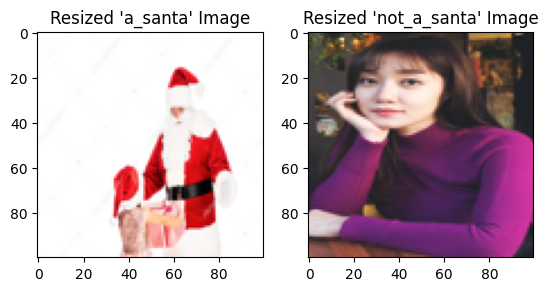

In [3]:
# Select one image from each category for display
a_santa_img = a_santa_images[0] if a_santa_images else None
not_a_santa_img = not_a_santa_images[0] if not_a_santa_images else None

# Display the resized images
plt.figure()

# Display resized 'a_santa' image
plt.subplot(1, 2, 1)
if a_santa_img is not None:
    plt.imshow(a_santa_img)
plt.title("Resized 'a_santa' Image")

# Display resized 'not_a_santa' image
plt.subplot(1, 2, 2)
if not_a_santa_img is not None:
    plt.imshow(not_a_santa_img)
plt.title("Resized 'not_a_santa' Image")

plt.show()

# data augmentation

split a santa and not a santa into each of 10 group

In [4]:
import copy

# Make a deep copy of the image lists before splitting
a_santa_images_copy = copy.deepcopy(a_santa_images)
not_a_santa_images_copy = copy.deepcopy(not_a_santa_images)

# Calculate the size of each group
group_size = len(a_santa_images) // 10
group_size = len(not_a_santa_images) // 10

a_santa_groups = {}
not_a_santa_groups = {}

# Split 'a_santa' images into 10 groups and name them
for i in range(10):
    group_name = f'a_santa_group_{i+1}'
    a_santa_groups[group_name] = a_santa_images_copy[i * group_size:(i + 1) * group_size]

# Split 'not_a_santa' images into 10 groups and name them
for i in range(10):
    group_name = f'not_a_santa_group_{i+1}'
    not_a_santa_groups[group_name] = not_a_santa_images_copy[i * group_size:(i + 1) * group_size]


# Augment fuction

In [5]:
import cv2

color_spaces = [
    cv2.COLOR_RGB2GRAY,
    cv2.COLOR_RGB2YUV,
    cv2.COLOR_RGB2HSV,
    cv2.COLOR_RGB2LAB,
    cv2.COLOR_RGB2HLS,
    cv2.COLOR_RGB2XYZ,
    cv2.COLOR_RGB2YCrCb,
    cv2.COLOR_RGB2Luv,
    cv2.COLOR_RGB2BGR,
    cv2.COLOR_RGB2BGRA
]

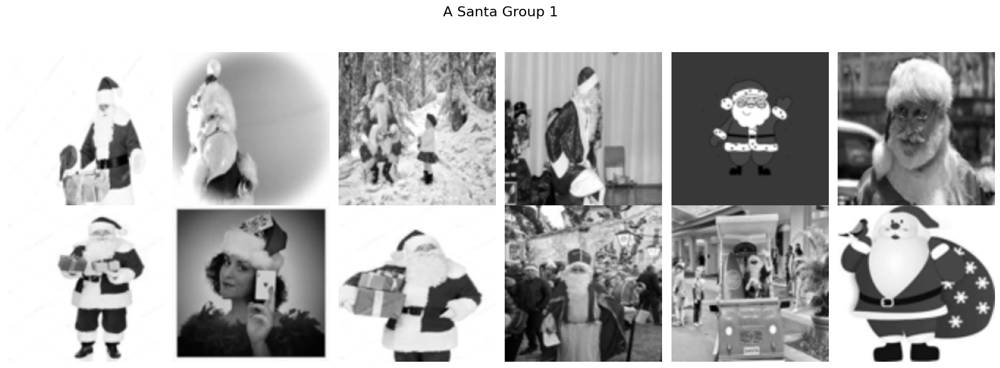

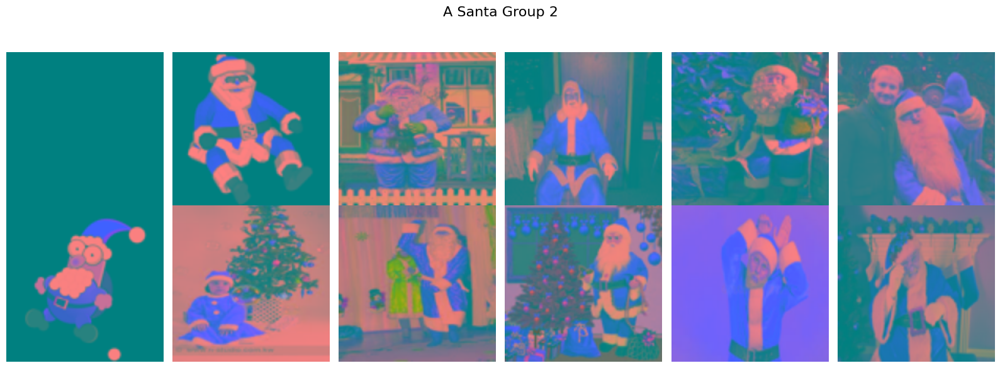

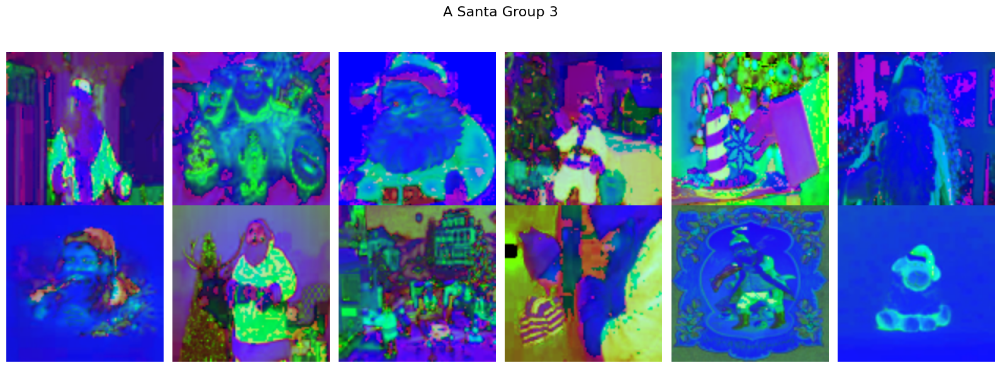

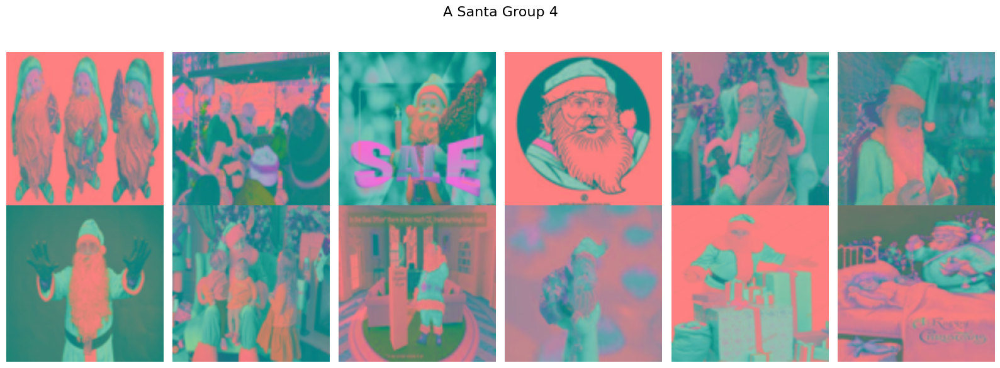

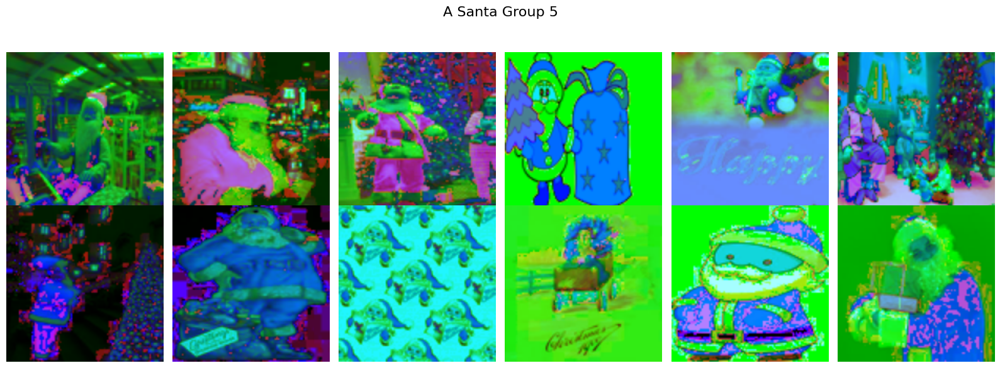

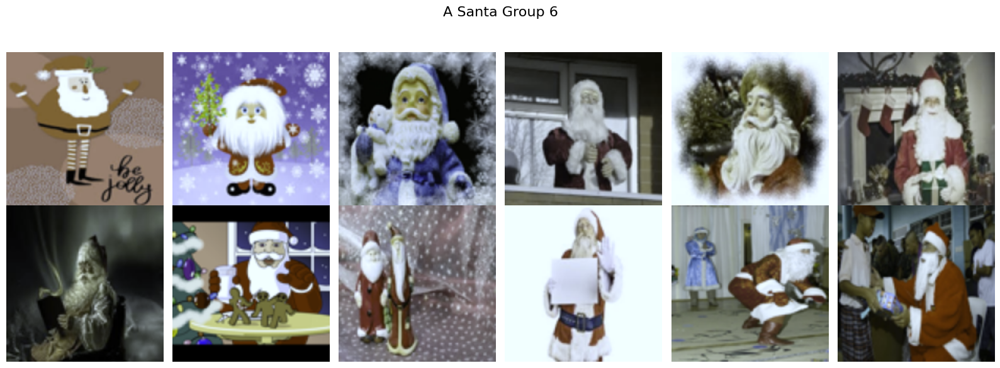

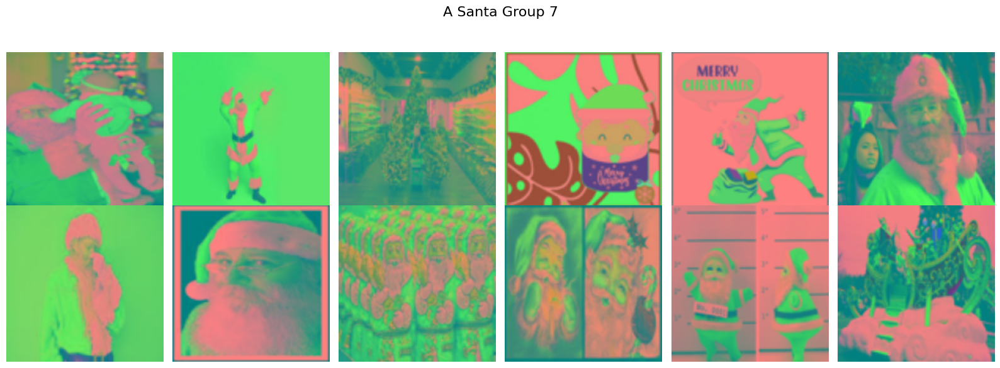

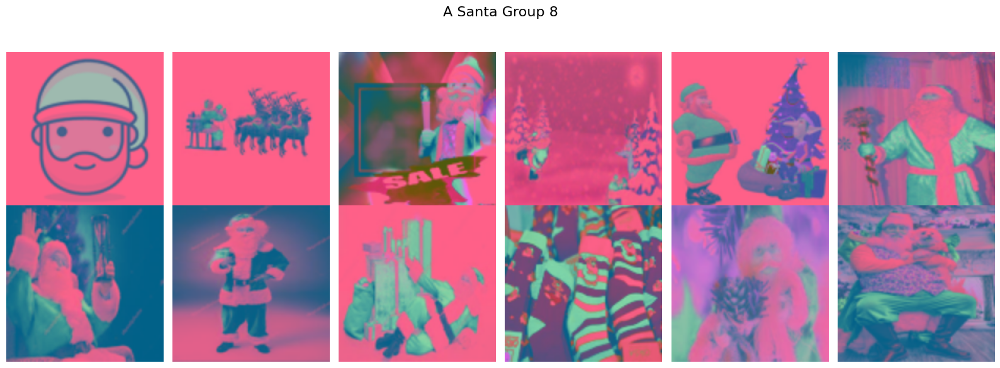

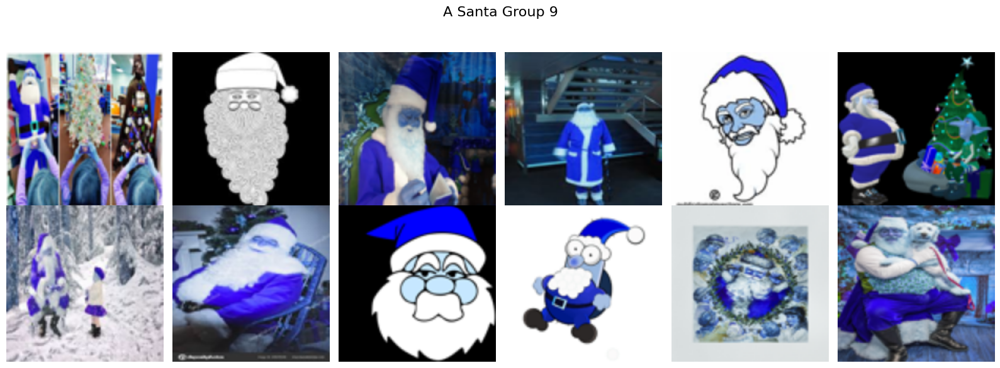

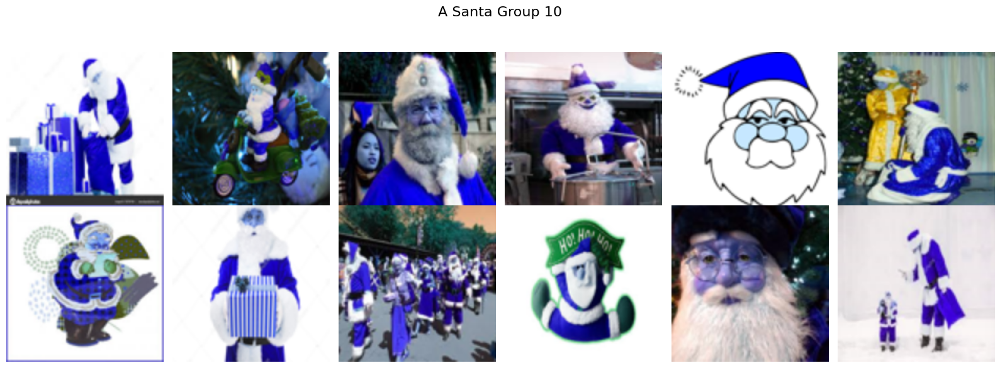

In [6]:
def plot_augments(title, images, color_space=None):
    fig, axes = plt.subplots(nrows=2, ncols=6, figsize=(16, 6))
    plt.suptitle(title, fontsize=16)
    count = 0  # Count to manage subplot indices

    for image in images:
        if not isinstance(image, np.ndarray):
            print(f"Skipping non-array image: {image}")
            continue
        # Convert image to 8-bit unsigned integer format if it's in float format
        if image.dtype == np.float32 or image.dtype == np.float64:
            image = (image * 255).astype(np.uint8)
        # Process the image for the specified color space
        if color_space is not None:
            image = cv2.cvtColor(image, color_space)
        image = cv2.resize(image, (200, 200))
        x = count // 6
        y = count % 6
        axes[x, y].imshow(image, cmap='gray' if color_space == cv2.COLOR_RGB2GRAY else None)
        axes[x, y].axis('off')
        count += 1
        if count >= 12:  # Only display the first 12 images
            break

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


# Plot each group with a different color space conversion
for i, (group_key, color_space) in enumerate(zip(a_santa_groups.keys(), color_spaces)):
    images = a_santa_groups[group_key]
    plot_augments(f"A Santa Group {i+1}", images, color_space)

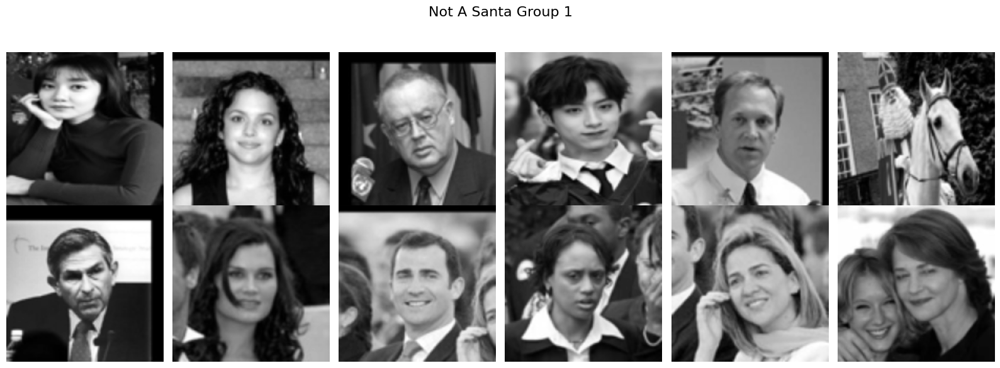

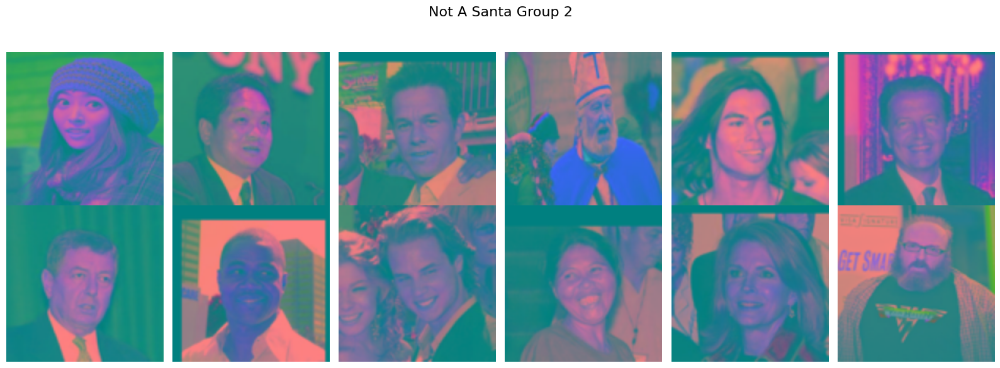

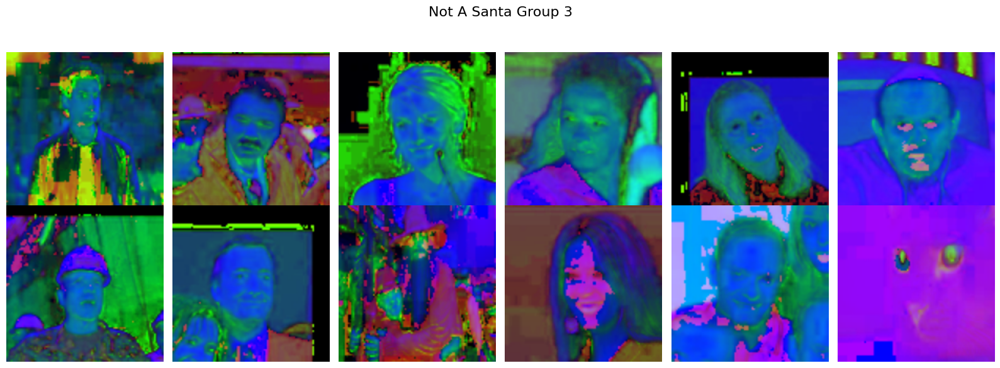

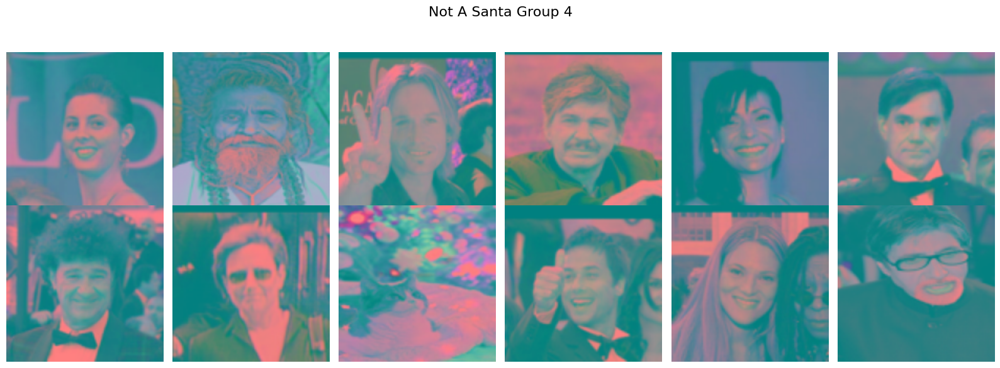

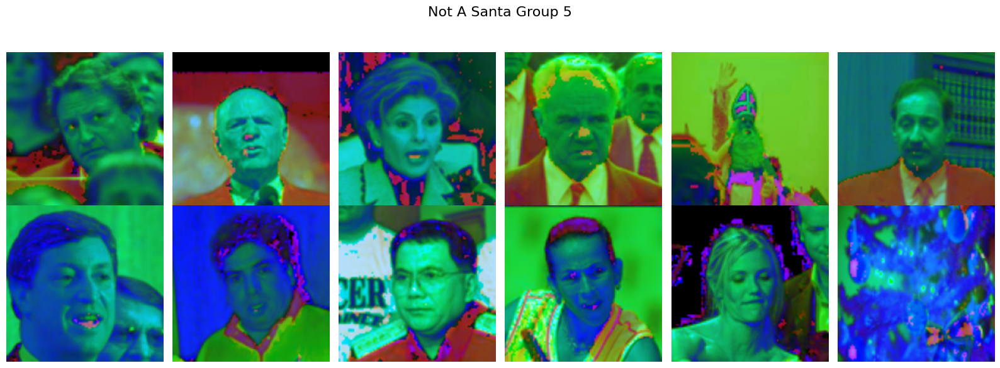

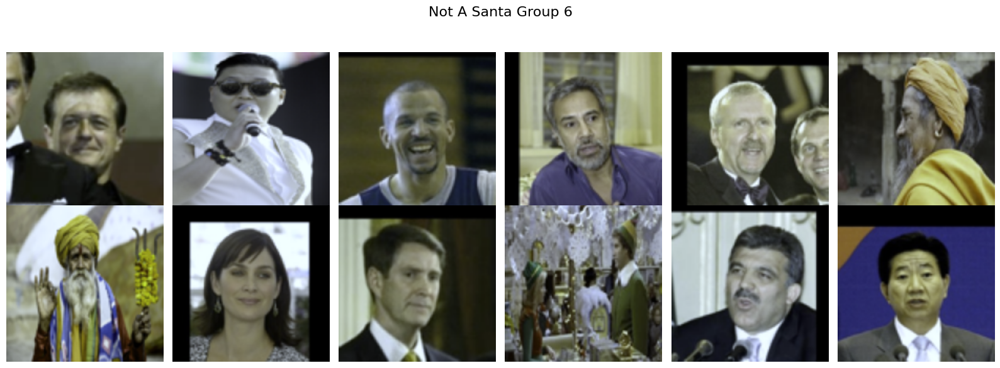

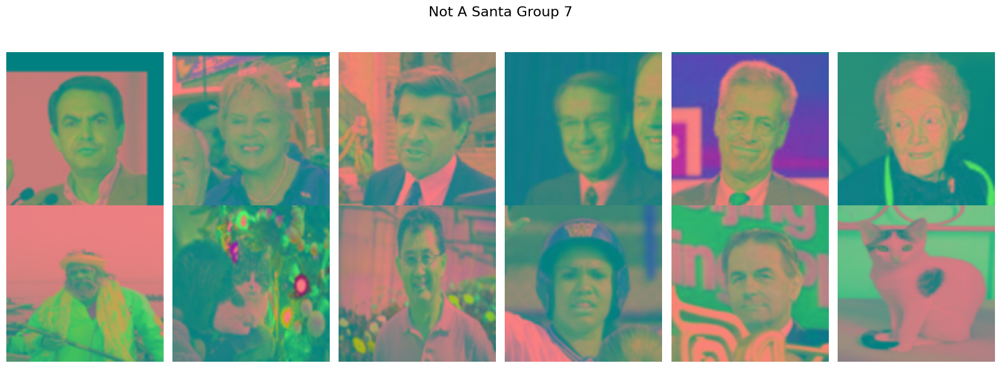

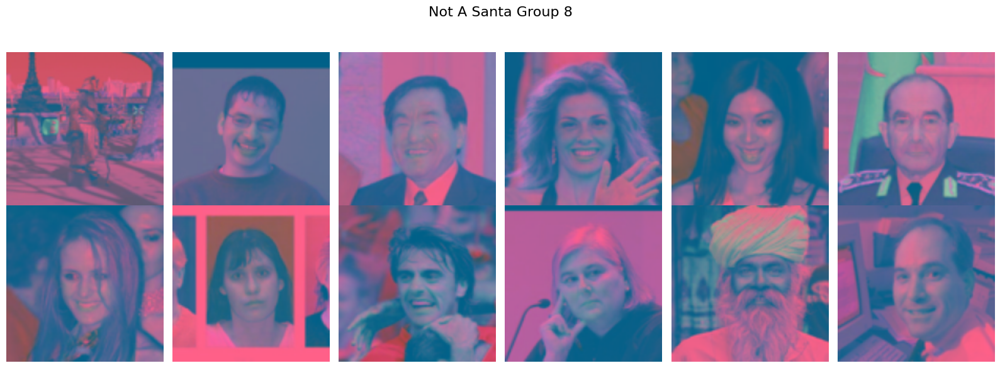

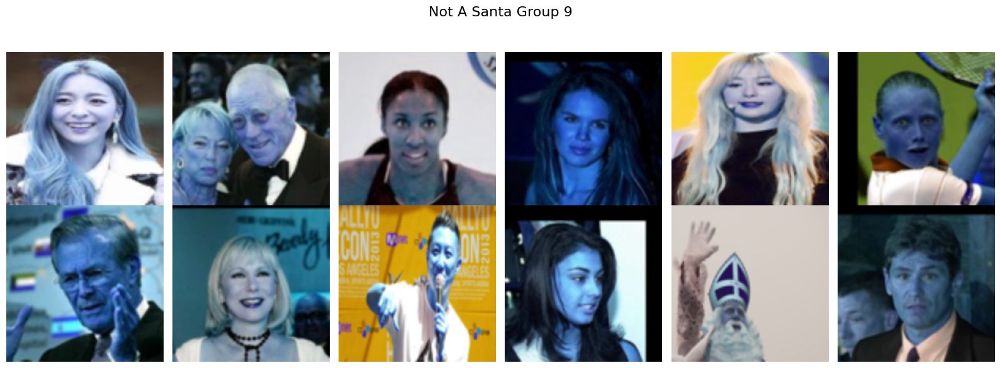

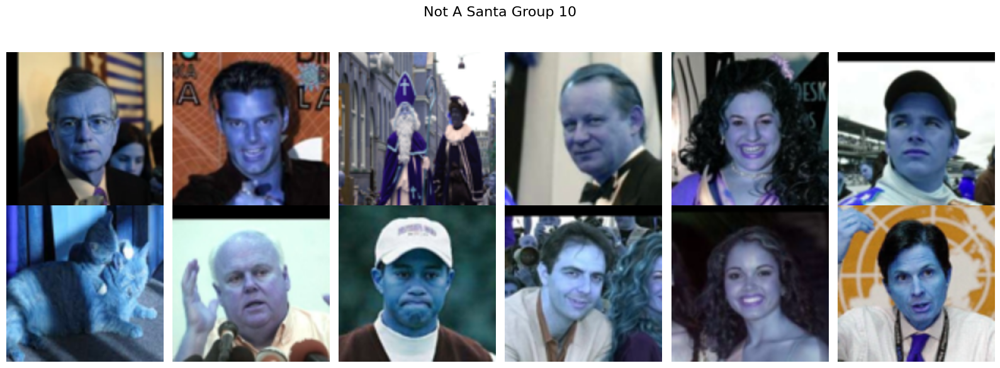

In [7]:
# Plot each group with a different color space conversion
for i, (group_key, color_space) in enumerate(zip(not_a_santa_groups.keys(), color_spaces)):
    images = not_a_santa_groups[group_key]
    plot_augments(f"Not A Santa Group {i+1}", images, color_space)


To combine all the groups back into a single list for both a_santa and not_a_santa

In [8]:
# Combine all the 'a_santa' groups back into a single list
combined_a_santa_images = []
for group_name in sorted(a_santa_groups.keys()):
    combined_a_santa_images.extend(a_santa_groups[group_name])

combined_not_a_santa_images = []
for group_name in sorted(not_a_santa_groups.keys()):
    combined_not_a_santa_images.extend(not_a_santa_groups[group_name])

# Verify that the combined lists have the correct number of images
print("Total number of 'augmentation_a_santa' images after combining:", len(combined_a_santa_images))
print("Total number of 'augmentation_a_not_santa' images after combining:", len(combined_not_a_santa_images))
print("Total number of 'a_santa' images after combining:", len(a_santa_images))
print("Total number of 'a_not_santa' images after combining:", len(not_a_santa_images))

Total number of 'augmentation_a_santa' images after combining: 300
Total number of 'augmentation_a_not_santa' images after combining: 300
Total number of 'a_santa' images after combining: 308
Total number of 'a_not_santa' images after combining: 308


In [9]:
# Combine all the 'a_santa' groups back into a single list
combined_a_santa_images = []
for group_name in sorted(a_santa_groups.keys()):
    combined_a_santa_images.extend(a_santa_groups[group_name])

combined_not_a_santa_images = []
for group_name in sorted(not_a_santa_groups.keys()):
    combined_not_a_santa_images.extend(not_a_santa_groups[group_name])

# Verify that the combined lists have the correct number of images
print("Total number of 'augmentation_a_santa' images after combining:", len(combined_a_santa_images))
print("Total number of 'augmentation_not_a_santa' images after combining:", len(combined_not_a_santa_images))

# Create labels for the combined images
processed_a_santa_labels = [1] * len(combined_a_santa_images)
processed_not_a_santa_labels = [0] * len(combined_not_a_santa_images)

# Combine data and labels
processed_images = np.array(combined_a_santa_images + combined_not_a_santa_images)
processed_labels = np.array(processed_a_santa_labels + processed_not_a_santa_labels)

# Shuffle the dataset
indices = np.arange(processed_images.shape[0])
np.random.shuffle(indices)
processed_images = processed_images[indices]
processed_labels = processed_labels[indices]

# Split the data into training and validation sets
train_images2, val_images2, train_labels2, val_labels2 = train_test_split(processed_images, processed_labels, test_size=0.2, random_state=42)

# Output the dataset sizes for verification
print("Total processed images:", len(processed_images))
print("Total processed labels:", len(processed_labels))
print("Shape of train_images2:", train_images2.shape)
print("Shape of val_images2:", val_images2.shape)
print("Shape of train_labels2:", train_labels2.shape)
print("Shape of val_labels2:", val_labels2.shape)

Total number of 'augmentation_a_santa' images after combining: 300
Total number of 'augmentation_not_a_santa' images after combining: 300
Total processed images: 600
Total processed labels: 600
Shape of train_images2: (480, 100, 100, 3)
Shape of val_images2: (120, 100, 100, 3)
Shape of train_labels2: (480,)
Shape of val_labels2: (120,)


# training

## model 1 : without augmentation

In [10]:
# create CNN Model
model = Sequential()
model.add(Conv2D(filters=32, kernel_size=(4, 4), input_shape=(100, 100, 3), activation='relu'))  # Convolutional Layer (1st)
model.add(MaxPool2D(pool_size=(2, 2)))                                                           # MaxPooling Layer (1st)
model.add(Conv2D(filters=32, kernel_size=(4, 4), activation='relu'))                             # Convolutional Layer (2nd)
model.add(MaxPool2D(pool_size=(2, 2)))                                                           # MaxPooling Layer (2nd)
model.add(Flatten())                                                                             # Flatten Layer
model.add(Dense(256, activation='relu'))                                                         # Fully Connected Dense Layer (1st)
model.add(Dense(1, activation='sigmoid'))                                                        # Fully Connected Dense Layer (2nd, Output)

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Model summary
model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 97, 97, 32)        1568      
                                                                 
 max_pooling2d (MaxPooling2  (None, 48, 48, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 45, 45, 32)        16416     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 22, 22, 32)        0         
 g2D)                                                            
                                                                 
 flatten (Flatten)           (None, 15488)             0         
                                                                 
 dense (Dense)               (None, 256)               3

In [11]:
history = model.fit(train_images, train_labels, epochs=10, validation_data=(val_images, val_labels))

Epoch 1/10
16/16 [==============================] - 6s 273ms/step - loss: 0.0496 - accuracy: 0.9431 - val_loss: 9.4709e-04 - val_accuracy: 1.0000
Epoch 2/10
16/16 [==============================] - 4s 230ms/step - loss: 7.8082e-15 - accuracy: 1.0000 - val_loss: 3.9058e-04 - val_accuracy: 1.0000
Epoch 3/10
16/16 [==============================] - 4s 232ms/step - loss: 7.5289e-19 - accuracy: 1.0000 - val_loss: 3.0979e-04 - val_accuracy: 1.0000
Epoch 4/10
16/16 [==============================] - 4s 233ms/step - loss: 5.3354e-19 - accuracy: 1.0000 - val_loss: 2.9402e-04 - val_accuracy: 1.0000
Epoch 5/10
16/16 [==============================] - 4s 234ms/step - loss: 3.4756e-19 - accuracy: 1.0000 - val_loss: 2.9077e-04 - val_accuracy: 1.0000
Epoch 6/10
16/16 [==============================] - 4s 227ms/step - loss: 3.3030e-19 - accuracy: 1.0000 - val_loss: 2.9011e-04 - val_accuracy: 1.0000
Epoch 7/10
16/16 [==============================] - 4s 235ms/step - loss: 3.2924e-19 - accuracy: 1.0000 

In [12]:
metrics = pd.DataFrame(model.history.history)
metrics

,loss,accuracy,val_loss,val_accuracy
0,4.962922e-02,0.943089,0.000947,1.0
1,7.808183e-15,1.000000,0.000391,1.0
2,7.528948e-19,1.000000,0.000310,1.0
3,5.335417e-19,1.000000,0.000294,1.0
4,3.475618e-19,1.000000,0.000291,1.0
5,3.302997e-19,1.000000,0.000290,1.0
6,3.292391e-19,1.000000,0.000290,1.0
7,3.285838e-19,1.000000,0.000290,1.0
8,3.284319e-19,1.000000,0.000290,1.0
9,3.284244e-19,1.000000,0.000290,1.0


4/4 [==============================] - 0s 50ms/step - loss: 2.8994e-04 - accuracy: 1.0000
Validation loss: 0.000289942225208506
Validation accuracy: 1.0


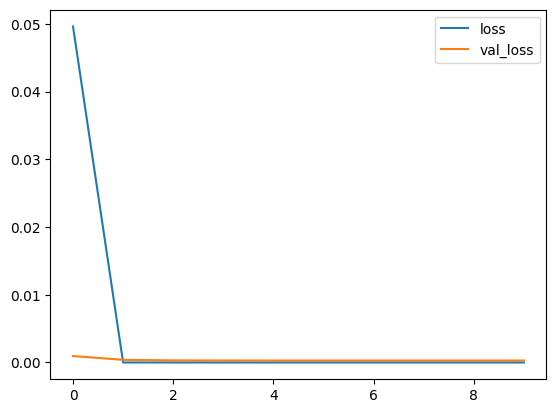

In [13]:
metrics[['loss', 'val_loss']].plot()
# Evaluate the model on the validation set
val_loss, val_accuracy = model.evaluate(val_images, val_labels)

# Print the results
print(f'Validation loss: {val_loss}')
print(f'Validation accuracy: {val_accuracy}')

## model 2 : with augmentation

In [14]:
# Define the model
model2 = Sequential([
    Conv2D(filters=32, kernel_size=(4, 4), input_shape=(100, 100, 3), activation='relu'),
    MaxPool2D(pool_size=(2, 2)),
    Conv2D(filters=64, kernel_size=(4, 4), activation='relu'),
    MaxPool2D(pool_size=(2, 2)),
    Flatten(),
    Dense(256, activation='relu'),
    Dense(1, activation='sigmoid')
])


In [15]:
model2.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Model summary
model2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 97, 97, 32)        1568      
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 48, 48, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_3 (Conv2D)           (None, 45, 45, 64)        32832     
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 22, 22, 64)        0         
 g2D)                                                            
                                                                 
 flatten_1 (Flatten)         (None, 30976)             0         
                                                                 
 dense_2 (Dense)             (None, 256)              

In [16]:
# Train the model
history2 = model2.fit(train_images2, train_labels2, epochs=10, validation_data=(val_images2, val_labels2))


Epoch 1/10
15/15 [==============================] - 6s 333ms/step - loss: 1.0743 - accuracy: 0.5271 - val_loss: 0.6037 - val_accuracy: 0.6000
Epoch 2/10
15/15 [==============================] - 5s 346ms/step - loss: 0.4858 - accuracy: 0.7875 - val_loss: 0.4225 - val_accuracy: 0.7500
Epoch 3/10
15/15 [==============================] - 5s 321ms/step - loss: 0.3145 - accuracy: 0.8562 - val_loss: 0.2352 - val_accuracy: 0.9000
Epoch 4/10
15/15 [==============================] - 5s 321ms/step - loss: 0.2116 - accuracy: 0.9167 - val_loss: 0.2367 - val_accuracy: 0.9000
Epoch 5/10
15/15 [==============================] - 5s 337ms/step - loss: 0.1202 - accuracy: 0.9604 - val_loss: 0.2273 - val_accuracy: 0.9000
Epoch 6/10
15/15 [==============================] - 5s 344ms/step - loss: 0.0812 - accuracy: 0.9792 - val_loss: 0.2807 - val_accuracy: 0.8833
Epoch 7/10
15/15 [==============================] - 5s 320ms/step - loss: 0.0394 - accuracy: 0.9875 - val_loss: 0.3673 - val_accuracy: 0.8750
Epoch 

# predict

In [21]:
def load_and_preprocess_Newimage(uploaded_image_bytes):
    # Convert bytes data to a file-like object
    img = Image.open(io.BytesIO(uploaded_image_bytes)).convert('RGB')
    # Resize the image
    img = img.resize((100, 100))  # Resize the image to 100x100 pixels
    # Convert to numpy array and normalize
    img_array = np.array(img) / 255.0
    # Add batch dimension
    img_array = np.expand_dims(img_array, axis=0)
    return img_array

upload new input to classtify SANTA!

1/1 [==============================] - 0s 122ms/step


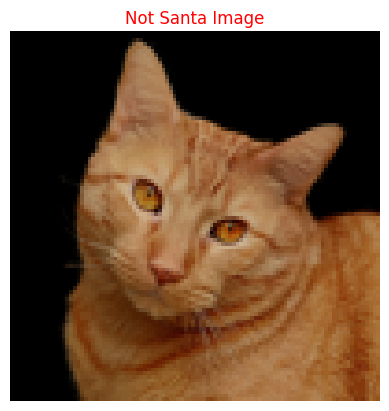

Model 1 prediction for '/kaggle/input/is-that-santa-image-classification/is that santa/test/not-a-santa/0.not-a-santa.jpg': Not Santa (score: 1.1987205910518798e-31)
1/1 [==============================] - 0s 82ms/step


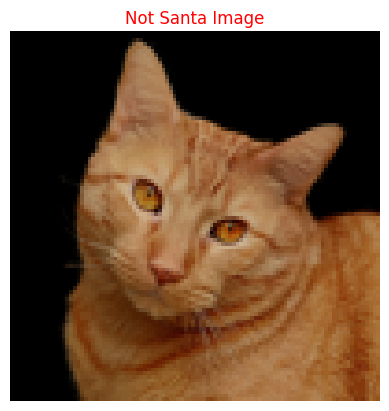

Model 2 prediction for '/kaggle/input/is-that-santa-image-classification/is that santa/test/not-a-santa/0.not-a-santa.jpg': Not Santa (score: 0.00030384029378183186)


In [18]:
uploaded_input_file_path = '/kaggle/input/is-that-santa-image-classification/is that santa/test/not-a-santa/0.not-a-santa.jpg'
uploaded_file_path = uploaded_input_file_path.strip()


def process_image_from_path(file_path):
    with open(file_path, 'rb') as f:
        content = f.read()
    return load_and_preprocess_Newimage(content)

# Model 1 predictions
processed_image = process_image_from_path(uploaded_file_path)

prediction = model.predict(processed_image)
plt.figure()
plt.imshow(processed_image[0])  # Show the first (and only) image

title_text = "Santa" if prediction[0][0] > 0.5 else "Not Santa"
title_color = 'green' if title_text == "Santa" else 'red'

plt.title(f"{title_text} Image", color=title_color)
plt.axis('off')
plt.show()
print(f"Model 1 prediction for '{uploaded_file_path}': {title_text} (score: {prediction[0][0]})")

# Model 2 predictions
processed_image = process_image_from_path(uploaded_file_path)

prediction = model2.predict(processed_image)
plt.figure()
plt.imshow(processed_image[0])  # Show the first (and only) image

title_text = "Santa" if prediction[0][0] > 0.5 else "Not Santa"
title_color = 'green' if title_text == "Santa" else 'red'

plt.title(f"{title_text} Image", color=title_color)
plt.axis('off')
plt.show()
print(f"Model 2 prediction for '{uploaded_file_path}': {title_text} (score: {prediction[0][0]})")


# Compare 2 models

To compare model and model2, use metrics such as accuracy, loss, and potentially.

*  Train both models: Ensure both model and model2 have been trained on the same
*  Evaluate the models: Use the evaluate method to assess the performance of each model on a test set (or validation set if a separate test set is not available).
*   Visualize the training process: Plot the training and validation accuracy/loss over epochs for each model to compare their learning behavior.



## Evaluate

In [19]:
# Evaluate the first model
model_loss, model_accuracy = model.evaluate(val_images, val_labels)
print(f"Model 1 - Loss: {model_loss}, Accuracy: {model_accuracy}")

# Evaluate the second model
model2_loss, model2_accuracy = model2.evaluate(val_images2, val_labels2)
print(f"Model 2 - Loss: {model2_loss}, Accuracy: {model2_accuracy}")

4/4 [==============================] - 0s 49ms/step - loss: 2.8994e-04 - accuracy: 1.0000
Model 1 - Loss: 0.000289942225208506, Accuracy: 1.0
4/4 [==============================] - 0s 72ms/step - loss: 0.3225 - accuracy: 0.8750
Model 2 - Loss: 0.32247239351272583, Accuracy: 0.875


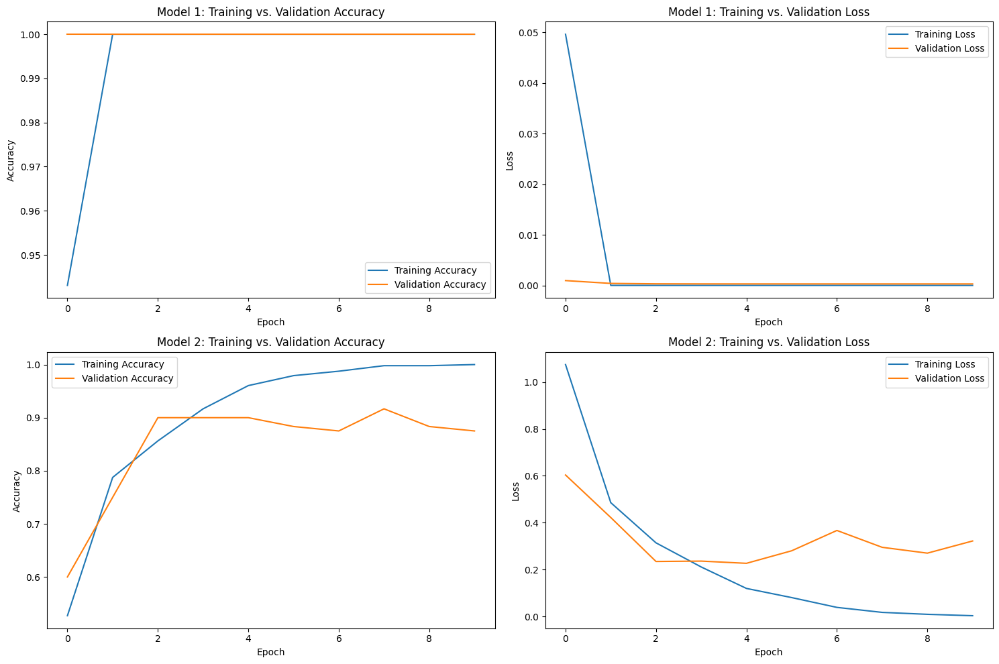

In [20]:
fig, axs = plt.subplots(2, 2, figsize=(15, 10))  # 2x2 grid, larger figure size

# Training and validation accuracy for Model 1
axs[0, 0].plot(history.history['accuracy'], label='Training Accuracy')
axs[0, 0].plot(history.history['val_accuracy'], label='Validation Accuracy')
axs[0, 0].set_title('Model 1: Training vs. Validation Accuracy')
axs[0, 0].set_ylabel('Accuracy')
axs[0, 0].set_xlabel('Epoch')
axs[0, 0].legend()

# Training and validation loss for Model 1
axs[0, 1].plot(history.history['loss'], label='Training Loss')
axs[0, 1].plot(history.history['val_loss'], label='Validation Loss')
axs[0, 1].set_title('Model 1: Training vs. Validation Loss')
axs[0, 1].set_ylabel('Loss')
axs[0, 1].set_xlabel('Epoch')
axs[0, 1].legend()

# Training and validation accuracy for Model 2
axs[1, 0].plot(history2.history['accuracy'], label='Training Accuracy')
axs[1, 0].plot(history2.history['val_accuracy'], label='Validation Accuracy')
axs[1, 0].set_title('Model 2: Training vs. Validation Accuracy')
axs[1, 0].set_ylabel('Accuracy')
axs[1, 0].set_xlabel('Epoch')
axs[1, 0].legend()

# Training and validation loss for Model 2
axs[1, 1].plot(history2.history['loss'], label='Training Loss')
axs[1, 1].plot(history2.history['val_loss'], label='Validation Loss')
axs[1, 1].set_title('Model 2: Training vs. Validation Loss')
axs[1, 1].set_ylabel('Loss')
axs[1, 1].set_xlabel('Epoch')
axs[1, 1].legend()

plt.tight_layout()
plt.show()


# *Model Comparison*

* Model 1 achieved perfect accuracy (100%) and an extremely low loss and an extremely low loss (nearly 0), which may indicate overfitting, especially if the training set is not diverse or too small.
* Model 2 showed an accuracy of 91.67% with a higher loss of 0.2993. This model might be more generalized compared to Model